<a href="https://colab.research.google.com/github/amirrshams/Deep-Learning/blob/main/Deep-Learning/Face%20Recognition%20Project/Face_Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# پروژه تشخیص چهره توسط شبکه‌های عصبی
## توسط امیررضا شمس‌الهدائي

# Step 1:
## Packages

In [ ]:
import keras
from keras.models import Sequential #Stacking The Layers
from keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, Dense, Flatten, Dropout, Activation
from keras.optimizers import Adam #Adam Optimizer
from keras.utils import np_utils #numpy utilities
 
import numpy as np #linear Algebra
import pandas as pd #Data Processing
import tensorflow as tf #tensorflow
import matplotlib.pyplot as plt #Plotting the result
import itertools #Functions creating iterators for efficient looping
 
from sklearn.model_selection import train_test_split #Skit Learn Library for machine Learning, Splitting Train and Test Datasets
from google.colab import files
%matplotlib inline

# Step 2:
## Loading the dataset

In [ ]:
files.upload()

Saving ORL_faces.npz to ORL_faces.npz


In [ ]:
Dataset = np.load("/content/ORL_faces.npz")
Dataset.files

['testY', 'testX', 'trainX', 'trainY']

In [ ]:
#Loading train images
x_train = Dataset['trainX']
#Normalizing train images
x_train = np.array(x_train,dtype='float32') / 255

#Loading test images
x_test = Dataset['testX']
#Normalizing test images
x_test = np.array(x_test,dtype='float32') / 255

#Loading the label of the images
y_train = Dataset['trainY']
y_test = Dataset['testY']

In [ ]:
print('training images shape: \t', x_train.shape)
print('training labels shape: \t', y_train.shape)
print('test images shape: \t', x_test.shape)
print('test labels shape: \t', y_test.shape)


training images shape: 	 (240, 10304)
training labels shape: 	 (240,)
test images shape: 	 (160, 10304)
test labels shape: 	 (160,)


In [ ]:
#Showing the train and test data formats
print('training images: \n', x_train)
print('test images: \n', x_test)
print('training labels shape: \n', y_train)
print('test labels shape: \n', y_test)

training images: 
 [[0.1882353  0.19215687 0.1764706  ... 0.18431373 0.18039216 0.18039216]
 [0.23529412 0.23529412 0.24313726 ... 0.1254902  0.13333334 0.13333334]
 [0.15294118 0.17254902 0.20784314 ... 0.11372549 0.10196079 0.11372549]
 ...
 [0.44705883 0.45882353 0.44705883 ... 0.38431373 0.3764706  0.38431373]
 [0.4117647  0.4117647  0.41960785 ... 0.21176471 0.18431373 0.16078432]
 [0.45490196 0.44705883 0.45882353 ... 0.37254903 0.39215687 0.39607844]]
test images: 
 [[0.16078432 0.18431373 0.18431373 ... 0.13725491 0.14509805 0.14901961]
 [0.17254902 0.16862746 0.1254902  ... 0.16862746 0.16862746 0.14509805]
 [0.16470589 0.16078432 0.17254902 ... 0.16470589 0.16862746 0.16078432]
 ...
 [0.39607844 0.39215687 0.40392157 ... 0.12156863 0.15686275 0.16470589]
 [0.4117647  0.42352942 0.41568628 ... 0.17254902 0.15686275 0.18431373]
 [0.44313726 0.44705883 0.43529412 ... 0.24313726 0.31764707 0.34901962]]
training labels shape: 
 [ 0  0  0  0  0  0  0  0  0  0  0  0  1  1  1  1  1  



```
# This is formatted as code
```

## Showing the images

In [ ]:
X = np.reshape(Dataset['trainX'], (240, 112, 92))
Y = Dataset['trainY']
X_test = np.reshape(Dataset['testX'], (160, 112, 92))
Y_test = Dataset['testY']

In [ ]:
def show_images(images):
    n = len(images)
    for i in range(n):
        plt.figure()
        plt.imshow(images[i])

 Training Images

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


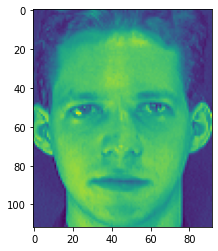

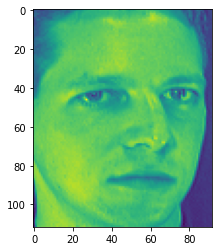

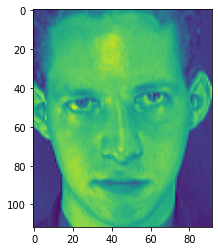

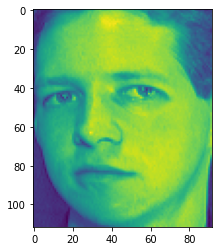

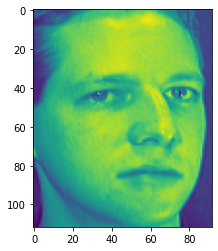

...

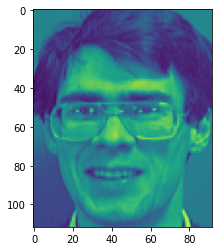

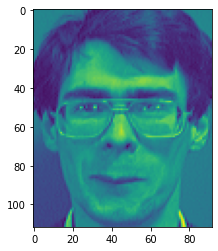

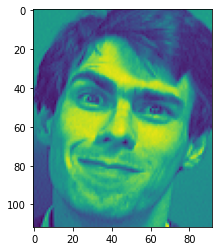

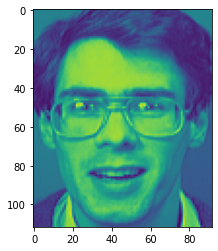

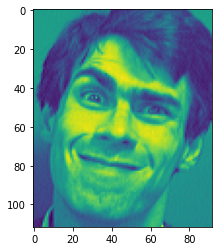

In [ ]:
show_images(X)

 Test images

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


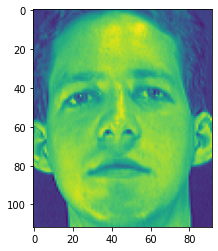

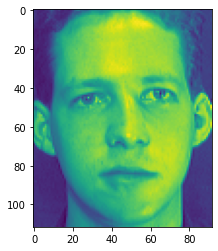

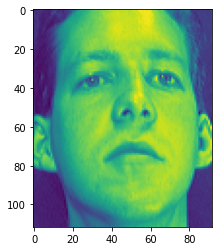

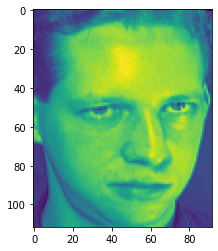

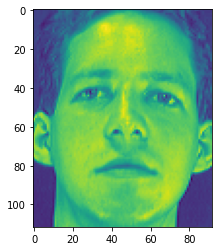

...

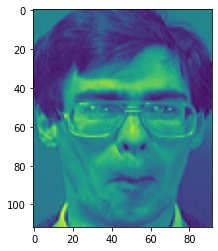

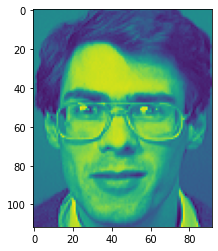

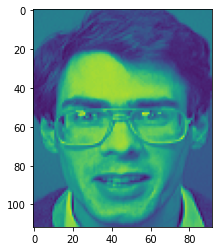

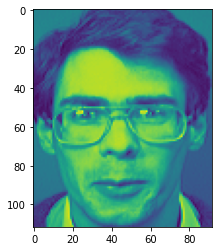

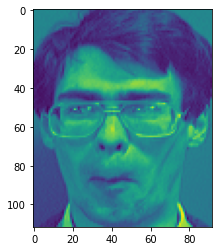

In [ ]:
show_images(X_test)

# Step 3:
## Data Validation and Reshaping the images

In [ ]:
x_train, x_valid, y_train, y_valid= train_test_split(x_train, y_train, test_size=0.05, random_state=1234)

In [ ]:
image_shape = (112, 92, 1)
batch_size = 512
X = x_train.reshape(x_train.shape[0], *image_shape)
X_test = x_test.reshape(x_test.shape[0], *image_shape)
X_valid = x_valid.reshape(x_valid.shape[0], *image_shape)

print('x_train shape: ',y_train.shape[0])
print('x_test shape: ',y_test.shape)

x_train shape:  228
x_test shape:  (160,)


## Step 4:
## Creating CNN model